# British birds
In this notebook we'll have a look at nearest-neighbor searches for birds. We start by loading the data:

In [13]:
using Glob, WAV, SpectralDistances, Serialization
using JLD2, FileIO, Flux, ProgressMeter
const fs = 44100
cd(@__DIR__)
##
using DSP, LPVSpectral
using AudioClustering
(..)(x::AbstractVector,i...) = getindex.(x,i...)

function show_classification_results(yh, permute=true)
    @show mean(labels .== yh)
    cm = confusmat(n_classes,labels,yh)
    if permute
        perm = amd(sparse(cm))
        cm = cm[perm,perm]
    end
    fig = heatmap(cm./sum(cm,dims=2), xlabel="Predicted class",ylabel="True class", title="Confusion Matrix", size=(1000,1000))
    anns = [(reverse(ci.I)..., text(val,6)) for (ci,val) in zip(CartesianIndices(cm)[:], vec(cm))]
    annotate!(anns)
    display(fig)
    cm
end

function predict_nn(labels, D)
    D = copy(D)
    D[diagind(D)] .= Inf
    dists, inds = findmin(D, dims=2)
    inds = vec(getindex.(inds, 2))
    yh = map(i->labels[i], inds)
end


trainpath = "/home/fredrikb/Downloads/bb-cluster71-data.jld2"
datadict = load("/home/fredrikb/Downloads/bb-cluster71-data.jld2")

ulabels = datadict["classnames"]
n_classes = length(ulabels)
# labels = datadict["class"] seems incorrect
sounds = datadict["data"]..1
labels = Int.(argmax.(datadict["data"]..2))

fs = 22500

22500

Next, we fit some linear models to the sound clips, this will take a few seconds
(I saved my estimated models to disk using serialization)

In [14]:
BLAS.set_num_threads(1)

modelspecs = collect(Iterators.product(10:2:14, (TLS,LS)))

#manymodels = @showprogress "Estimating models" map(modelspecs) do (na, fm)
#    fitmethod = fm(na=na, λ=1e-5)
#    tmap(sounds) do sound
#        sound = @view(sound[findfirst(!iszero, sound):findlast(!iszero, sound)])
#        sound = Float32.(SpectralDistances.bp_filter(sound, (50 / fs, 0.49)))
#        fitmethod(sound)
#    end
#end
# serialize("manymodels",manymodels)
manymodels = deserialize("manymodels")
models = manymodels[end]

manyX = embeddings.(manymodels);

We can now use the embeddings extracted from the linear models to find nearest neighbors. We'll plot the percentage of times the top `k` nearest classes from a sound clip contain the class of the clip. 

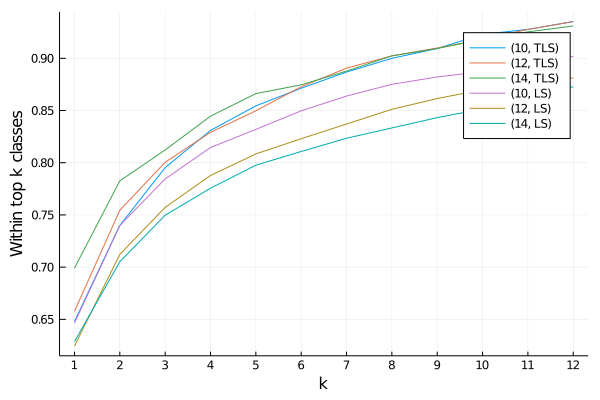

In [15]:
## KNN classifier ============================================================================
using MultivariateStats, MLBase, AMD, NearestNeighbors
function knn_classify(labels, X, k)
    N = size(X,2)
    W = fit(Whitening, X)
    X = MultivariateStats.transform(W,X)
    tree = NearestNeighbors.KDTree(X)
    map(1:N) do i
        inds, dists = knn(tree, X[:,i], min(5k+1, N-1), true)
        # mode(labels[inds[2:end]])# Discard first self match
        ul = unique(labels[inds[2:end]])
        ul[1:min(k, length(ul))]
    end
end
plot()
for (i,X) in enumerate(manyX)
    kvec = 1:12
    accs = tmap(kvec) do k
        nns = knn_classify(labels,X,k)
        mean(labels .∈ nns)
    end
    plot!(kvec, accs, ylabel="Within top k classes", xlabel="k", xticks=1:12, lab=string(modelspecs[i]))
end
current()

Below, we'll visualize the confusion matrix associated with the classification. AMD is used to rearrange the confusion matrix to form nice clusters

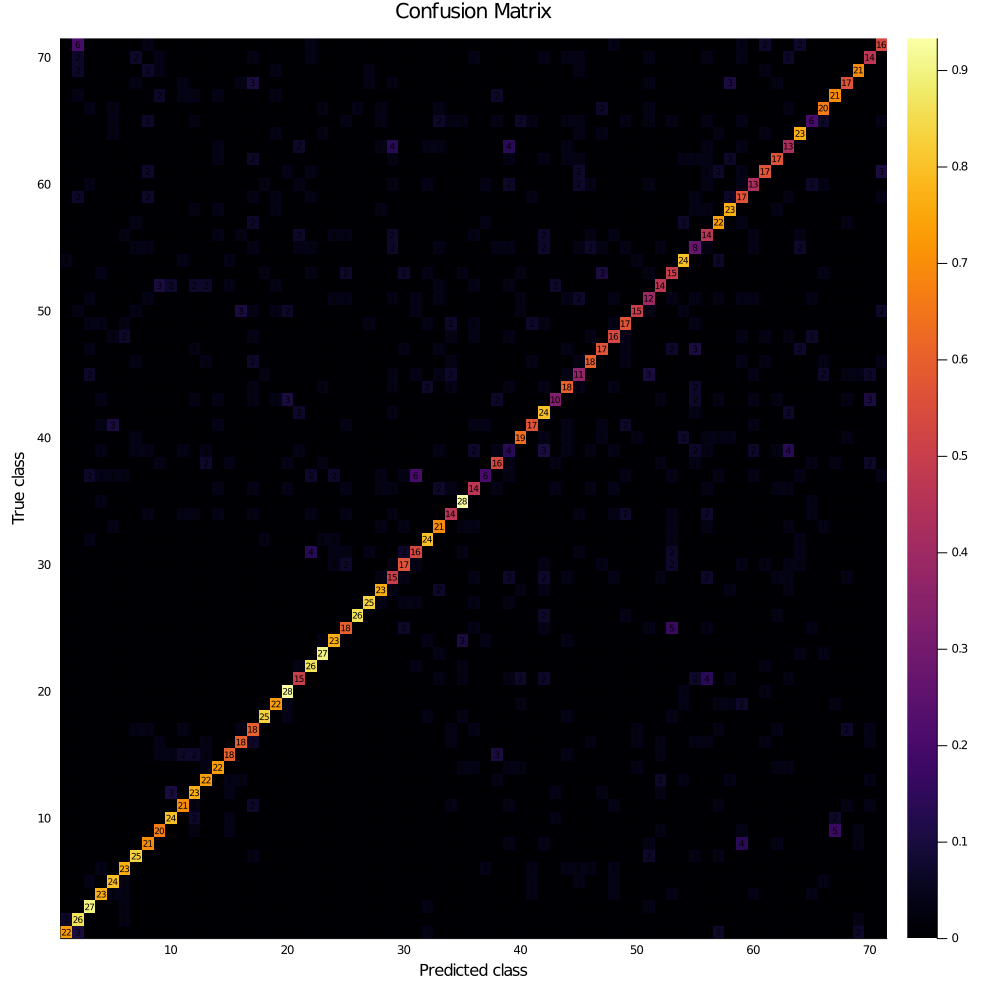

mean(labels .== yh) = 0.6286384976525822


In [16]:
yh_erd = first.(knn_classify(labels,manyX[end],1))
cm = show_classification_results(yh_erd);

We'll now do exactly the same thing but using the Optimal Transport Root Distance (OTRD). It will take a couple of minutes to calculate the full distance matrix here.

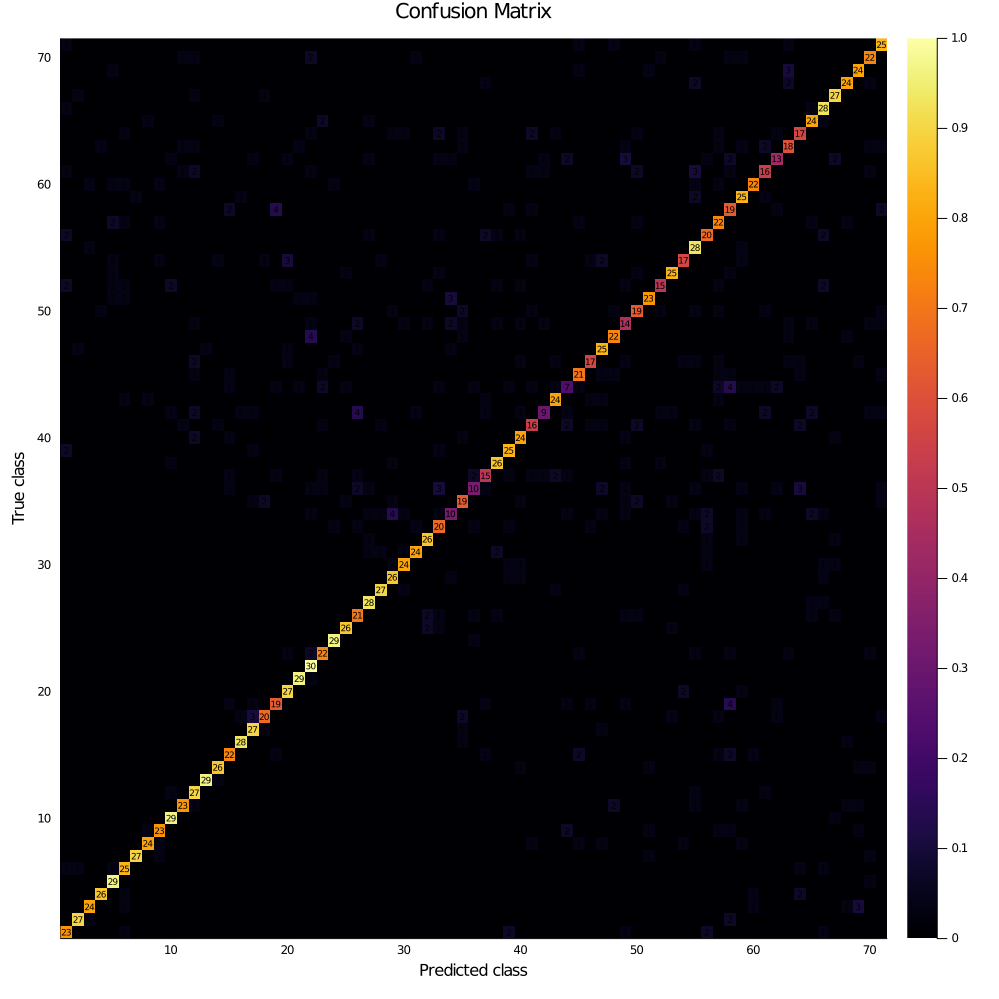

(size(inds), size(labels)) = ((2130,), (2130,))
mean(labels .== yh) = 0.748356807511737


In [17]:
d = OptimalTransportRootDistance(p=1, β=0.05, divergence=KL(0.5))
# @time D = distmat(d, models; normalize=true, tol=1e-4, iters=2000) # This takes a while (2 min) to compute. Make sure julia is started with multiple threads
# serialize("D",D)
D = deserialize("D")

yh_otrd = predict_nn(labels, D)
cm = show_classification_results(yh_otrd);

Once again we do exactly the same thing, but this time for an optimal-transport distance calculated between spectrograms. This will take quite a while to compute (10 minutes unless you have a large number of cores in your CPU)

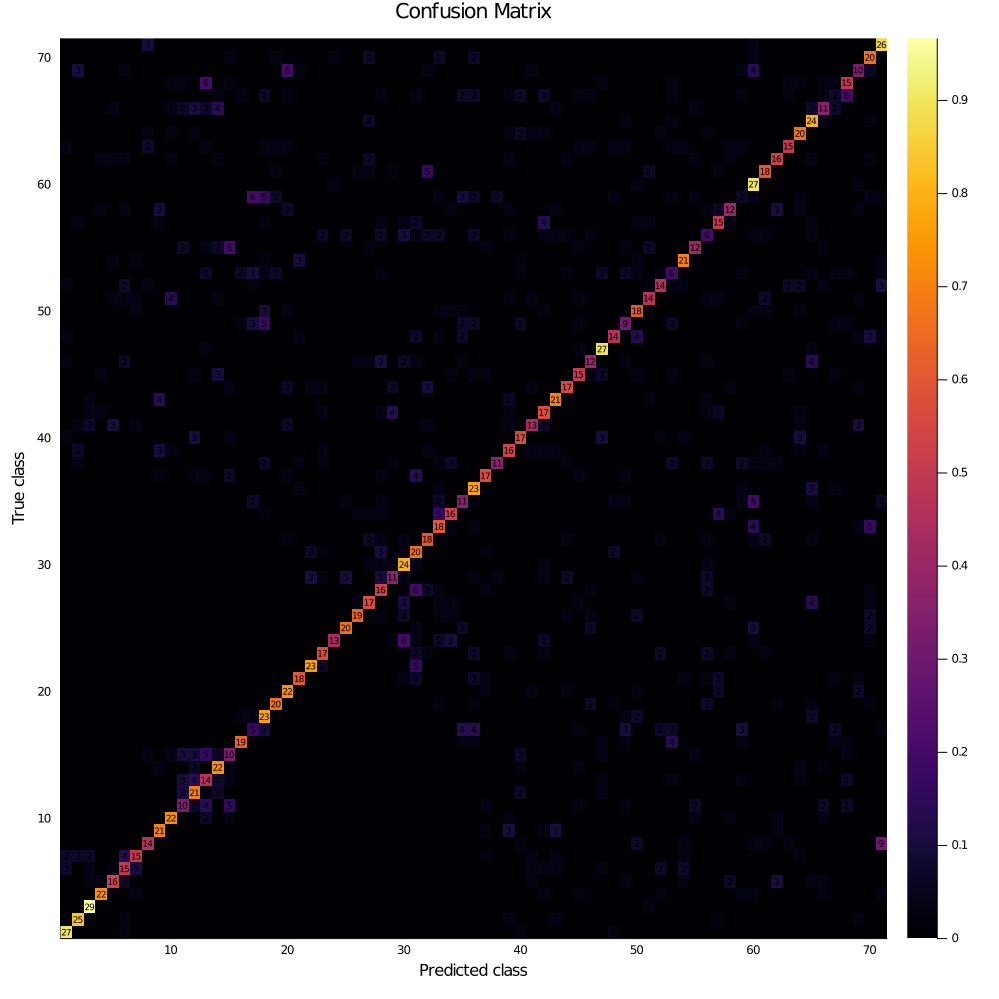

(size(inds), size(labels)) = ((2130,), (2130,))
mean(labels .== yh) = 0.5568075117370892


In [18]:
BLAS.set_num_threads(1)
d = ConvOptimalTransportDistance(β=0.01)
spectrograms = melspectrogram.(sounds, fs=fs, fmin=50)
# @time Dc = distmat(d, spectrograms; normalize=true, tol=1e-3, iters=50)
# serialize("D",Dc)
Dc = deserialize("Dc")

yh_c = predict_nn(labels, Dc)
cm = show_classification_results(yh_c);

The last distance we'll consider is the Kernel Wasserstein distance

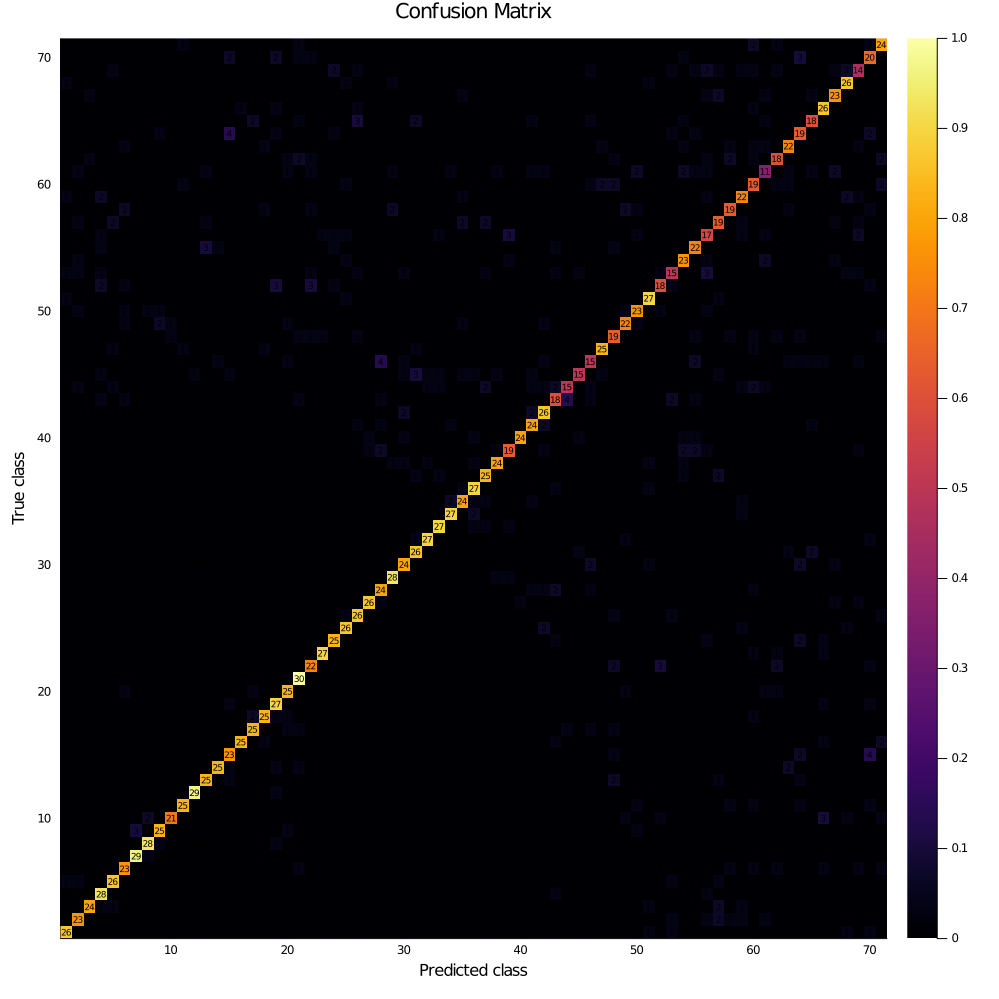

 11.637000 seconds (22.75 M allocations: 7.886 GiB, 13.93% gc time)
(size(inds), size(labels)) = ((2130,), (2130,))
mean(labels .== yh) = 0.7694835680751174


In [19]:
## NN classification with Kernel distance
d = KernelWassersteinRootDistance(λ=30.0)
models = manymodels[3]
#@time Dk = distmat(d, models; normalize=true)
# serialize("Dk",Dk)
Dk = deserialize("Dk")

yh_k = predict_nn(labels, Dk)
cm = show_classification_results(yh_k);

Now we have a number of different distances computed between all sound clips. Below, we'll let

1) Each distance vote for the correct class to produce a single prediction
2) See how often at least one of the distances get's the class right

The confusion matrix is associated with the voting method

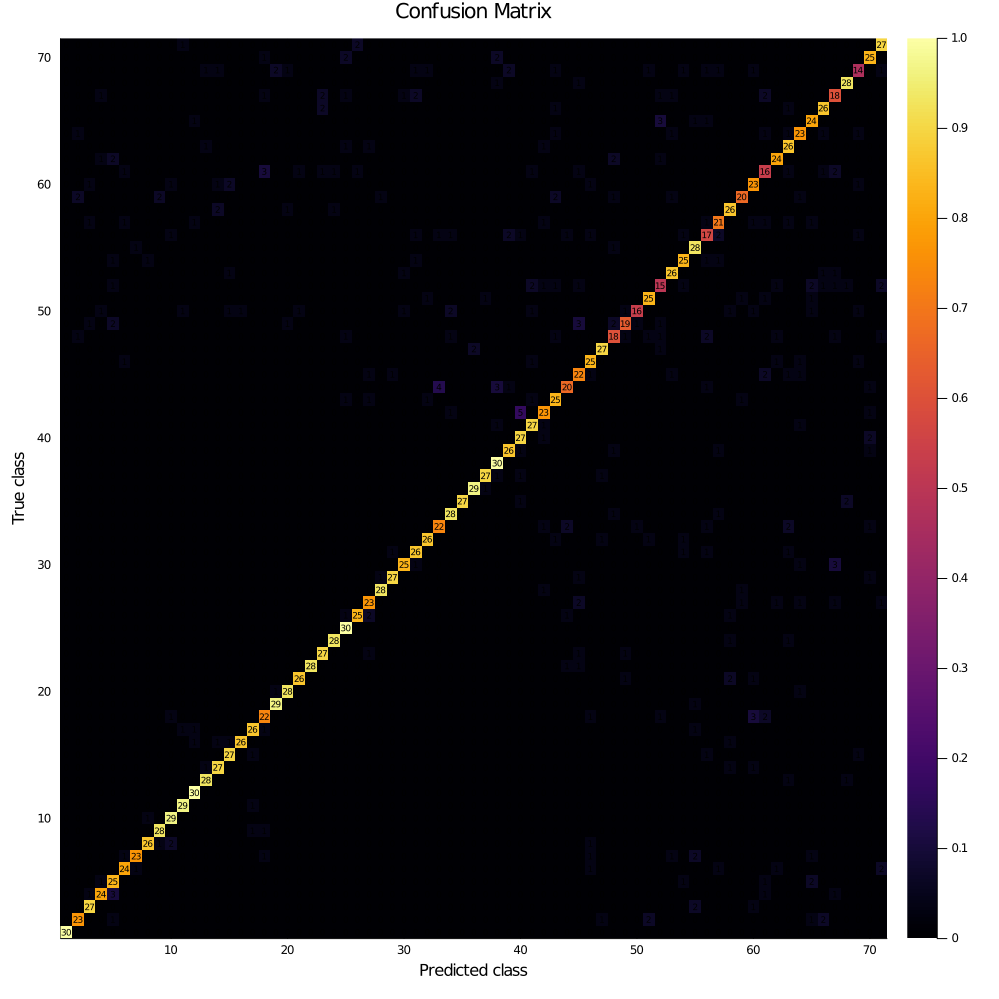

mean(labels .== majority_vote) = 0.8286384976525821
mean(labels .∈ k_votes) = 0.9455399061032864
mean(labels .== yh) = 0.8286384976525821


In [23]:
## Use all distances
function vote(preds)
    map(1:length(preds[1])) do i
        mode(getindex.(preds, i))
    end
end

function ranking(labels, preds)
    scores = [mean(labels .== yh) for yh in preds]
    sortperm(scores, rev=true)
end

function predict_k(labels, preds, k)
    map(eachindex(labels)) do i
        cm = countmap(getindex.(preds, i)) |> collect |> x->sort(x, by=last, rev=true)
        first.(cm[1:min(k,length(cm))])
    end
end

# votes = [yh_erd, yh_otrd, yh_c, yh_td]
votes = [first.(knn_classify(labels,X,1)) for X in vec(manyX)]
votes = [yh_k, votes..., yh_otrd, yh_c]

k_votes = predict_k(labels, votes, 7)

r = ranking(labels, votes)
majority_vote = vote(votes)

@show mean(labels .== majority_vote)
@show mean(labels .∈ k_votes)
cm = show_classification_results(majority_vote);

The figure below indicates the distribution of the number of predicted classes. Quite often, all classifiers agree and a 1-3 classes are predicted (>50% of the time). However, in a small number of cases, all 7 classifiers disagrees and 7 different classes are predicted.

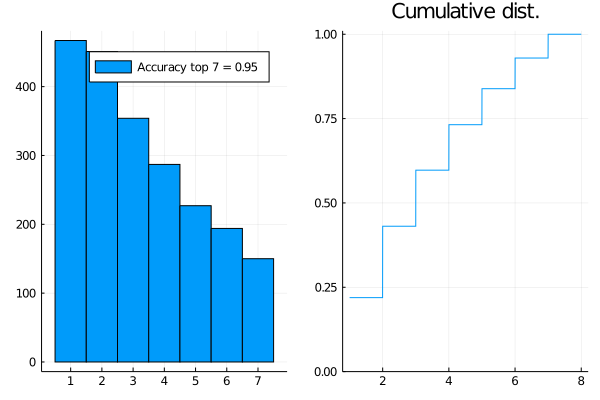

In [21]:
cdf_ = MLBase.ecdf(length.(k_votes))
plot(
    histogram(
        length.(k_votes),
        bins = (1:8) .- 0.5,
        lab = "Accuracy top 7 = $(round(mean(labels .∈ k_votes), sigdigits=2))",
        cumulative = true,
    ),
    plot(x -> cdf_(x), 1, 8, title="Cumulative dist.", lab="", ylims=(0,1.01)),
)

## Feature-based classification
Next, we attempt to classify using a random forest on the model embeddings

In [22]:
using DecisionTree, MultivariateStats
manyZ = [reduce(hcat, simplex_residueweight.(models)) for models in manymodels]
X = [manyX[3]' manyX[6]' manyZ[4]']
y = labels
N = length(labels)
k = 7 # Predict this many classes

mean(1:5) do _ # This simply trains 5 times and takes the average
    perm = shuffle(1:N)

    Nt = 1800
    train_x = X[perm[1:Nt], :]
    train_y = y[perm[1:Nt]]
    test_x = X[perm[Nt+1:end], :]
    test_y = y[perm[Nt+1:end]]

    # W = fit(ICA, copy(train_x'), 25, tol=1e-4) # This does not appear to improve performance
    # train_x = transform(W,train_x')' |> copy
    # test_x = transform(W,test_x')' |> copy

    model = RandomForestClassifier(n_trees=400, max_depth=15)
    DecisionTree.fit!(model, train_x, train_y)

    predictions = DecisionTree.predict(model, test_x)
    k_predictions =
    getindex.(sortperm.(eachrow(predict_proba(model, test_x)), rev = true), Ref(1:k)) # Predict top k classes
    @assert all(predictions .∈ k_predictions)
    # @show accuracy = mean(predictions .== test_y) # Top 1 class accuracy
    @show accuracy = mean(test_y .∈ k_predictions)  # Top k class accuracy

end

accuracy = mean(test_y .∈ k_predictions) = 0.9454545454545454
accuracy = mean(test_y .∈ k_predictions) = 0.9424242424242424
accuracy = mean(test_y .∈ k_predictions) = 0.9484848484848485
accuracy = mean(test_y .∈ k_predictions) = 0.9363636363636364
accuracy = mean(test_y .∈ k_predictions) = 0.9424242424242424
accuracy = mean(test_y .∈ k_predictions) = 0.9424242424242424


0.9424242424242424

The top 7 accuracy of the random forest is on par with the distance-based classifier. However, they do have different pros and cons
- The random forest can easily incorporate other features.
- The distance-based classifier can incorporate new data without re-training and can find a similar sound without a any labels.